In [3]:
from IPython.display import HTML
HTML('''<script>
code_show=true; 
function code_toggle() {
 if (code_show){
 $('div.input').hide();
 } else {
 $('div.input').show();
 }
 code_show = !code_show
} 
$( document ).ready(code_toggle);
</script>
The raw code for this IPython notebook is by default hidden for easier reading.
To toggle on/off the raw code, click <a href="javascript:code_toggle()">here</a>.''')

In [4]:
%%javascript
IPython.OutputArea.prototype._should_scroll = function(lines) {
    return false;
}

<IPython.core.display.Javascript object>

In [5]:
from IPython.display import display, HTML

display(HTML(data="""
<style>
    div#notebook-container    { width: 95%; }
    div#menubar-container     { width: 95%; }
    div#maintoolbar-container { width: 99%; }
</style>
"""))

Q0275
98


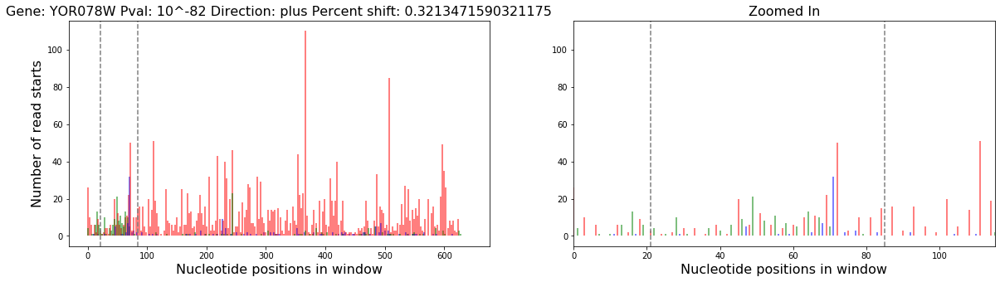

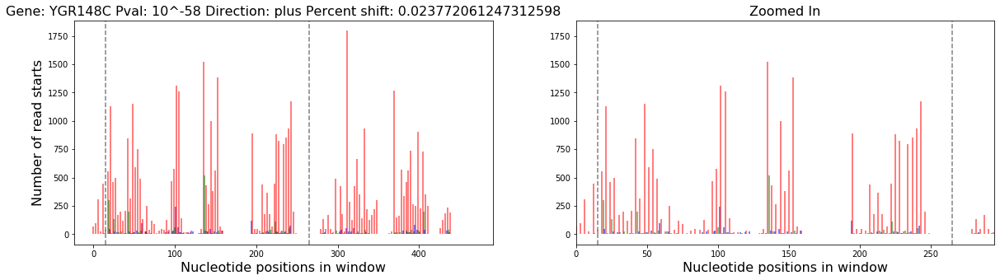

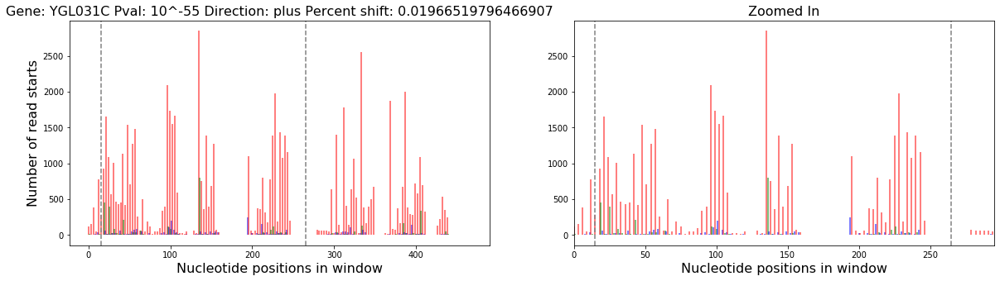

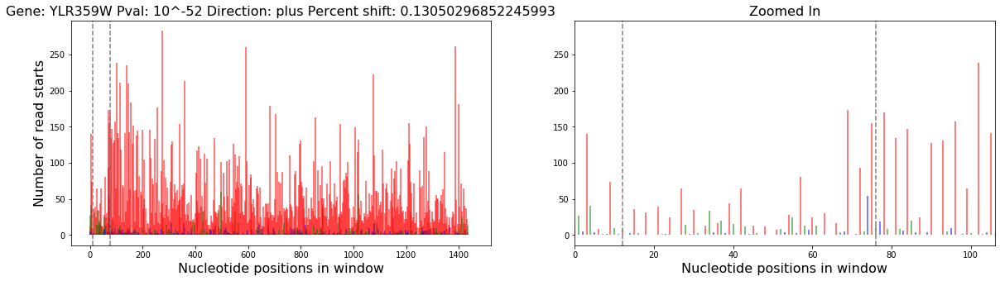

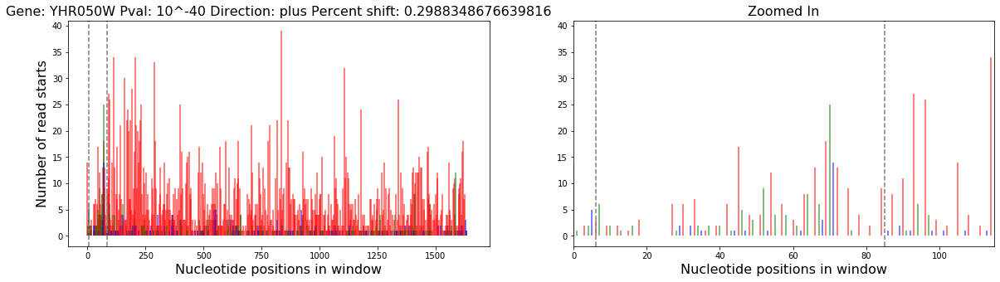

...

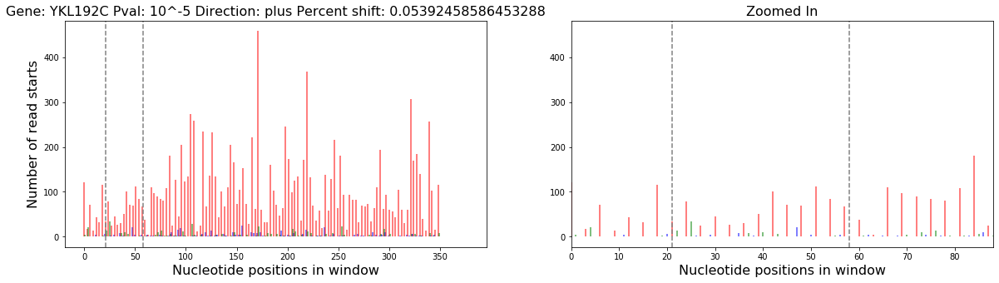

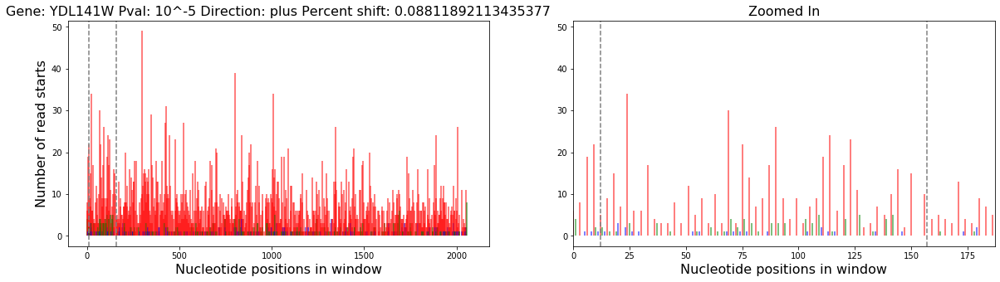

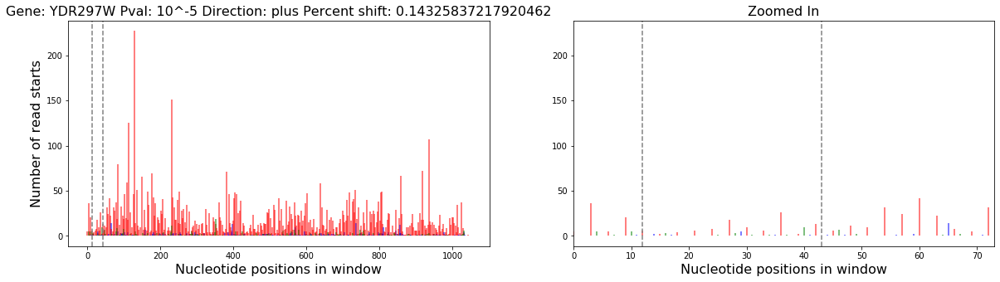

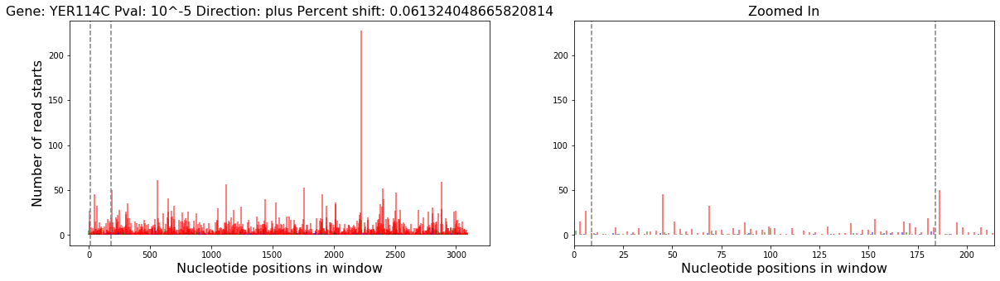

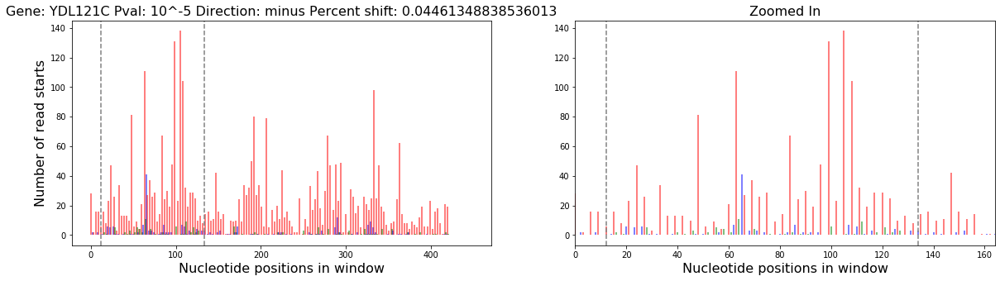

In [7]:
##### THIS is for before gene starts

import pandas as pd
import matplotlib.pyplot as plt
from matplotlib import collections as matcoll
inFile = open("output/combined_starts_four_sets_above_90", "r")
gene = inFile.readline().strip()
lineListDict = dict()
while gene:                                                                                                                                                    
    seq = inFile.readline()                                                                                                                                   
    starts_string = inFile.readline()                                                                                                                          
    current_gene = gene                                                                                                                                        
    gene = inFile.readline().strip()                                                                                                                           
    lineList = [int(x) for x in starts_string.strip()[:-1].split(",")] 
    lineListDict[current_gene] = lineList
inFile = open("output/combined_starts_four_sets_above_90_with_found_frameshifts_approach_5.5", "r")
genePDict = dict()
geneShiftStartDict = dict()
geneShiftEndDict = dict()
genePercent = dict()
geneDirection = dict()
geneBefore = dict()
for line in inFile:
    Info_string = line.strip()
    letters = inFile.readline().rstrip("\n").split(" ")
    reads_1 = inFile.readline().rstrip("\n").split(" ")
    reads_2 = inFile.readline().rstrip("\n").split(" ")
    percents = inFile.readline().rstrip("\n").split(",")
    blank = inFile.readline()
    gene_name = Info_string.split("\t")[0].split(" ")[1]
    p_value  = float(Info_string.split("\t")[1].split(" ")[1])

    
    detected_shift = int(Info_string.split("\t")[3].split(" ")[1])
    detected_shift_end = detected_shift + int(Info_string.split("\t")[4].split(" ")[1])
    
    geneDirection[gene_name] = Info_string.split("\t")[5].split(" ")[1]
    if ( Info_string.split("\t")[6].split(" ")[1] == "yes" ):
        geneBefore[gene_name] = "yes"
    genePercent[gene_name] = float(Info_string.split("\t")[7].split(" ")[1])

    genePDict[gene_name] = p_value
    geneShiftStartDict[gene_name] = detected_shift
    geneShiftEndDict[gene_name] = detected_shift_end
    
sorted_PVals = sorted(genePDict.items(), key=lambda x: x[1])

# now process the ids file
sgdToGeneName = dict()
inFile = open("saccharomyces_cerevisiae_gene_info.csv", "r")
inFile.readline()
for line in inFile:
    i_string = line.strip().split("\t")
    sgdToGeneName[i_string[1]] = i_string[3].split(" ")[0]
    
print(sgdToGeneName["SGDID:S0007283"])

# now process the secondary structure file - this was the initial filter to see we can compare to PRFDB
#inFile = open("saccharomyces_cerevisiae_mfe.csv", "r")
#inFile.readline()
#geneStructuresDict = dict()
#geneDistDict = dict()
#for line in inFile:
#    i_string = line.strip().split("\t")
#    if (i_string[2] in sgdToGeneName):
#        gene_name = sgdToGeneName[i_string[2]]
#        if (gene_name in genePDict):
#found += 1
##if (gene_name not in geneStructuresDict):
#            start = int(i_string[4])
#            my_start = geneShiftStartDict[gene_name]
#            if (abs(start - my_start) < 30):
#                geneStructuresDict[gene_name] = i_string
            #TODO: decide if want to have a distance cut-off, like 10 or 30, of get best distance first, and then do cut-offs??
#print(found)
#print(len(geneStructuresDict))
#for gene_name in geneStructuresDict:
    #print(geneStructuresDict[gene_name])
    #print(genePDict[gene_name])

print(len(geneBefore))
    
outFile = open("BeforeGene_FoundMay11.csv", "w")
for (gene, p_val) in sorted_PVals:
    
    ### un-comment this line to get only things with PRFDB secondary structures...
    ##if gene not in geneStructuresDict:
     ##   continue
    if gene not in geneBefore:
        continue
        
    lines = []
    lineList = lineListDict[gene]
    for i in range(0, len(lineList)):  # YDL061C,87,140,-1,0.05; -54.349  #YLR388W,75,140,-1,0.05; -30.754
        pair=[(i,0), (i, lineList[i])]
        lines.append(pair)
    linecoll = matcoll.LineCollection(lines, colors=["red","green", "blue"], linewidths=[2], alpha=0.5)
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 5))
    ax1.add_collection(linecoll)
    ax1.axvline(x=geneShiftStartDict[gene], c="gray", linestyle='--')
    ax1.axvline(x=geneShiftEndDict[gene], c="gray", linestyle='--')
    ax1.autoscale_view()
    ax1.set_title("Gene: " + str(gene) + " Pval: 10^" + str(round(p_val)) + " Direction: " + geneDirection[gene] + " Percent shift: " + str(genePercent[gene]),fontsize=16)
    ax1.set_xlabel('Nucleotide positions in window',fontsize=16)
    ax1.set_ylabel('Number of read starts',fontsize=16)
    
    
    start = 2 * geneShiftStartDict[gene] - geneShiftEndDict[gene]
    start = max(0, start - start%3 - 30)
    end = min(geneShiftEndDict[gene] + 30, len(lineList))
    lineList = lineListDict[gene]
    lines= []
    for i in range(0, len(lineList)): 
        pair=[(i,0), (i, lineList[i])]
        lines.append(pair)
    linecoll = matcoll.LineCollection(lines, colors=["red","green", "blue"], linewidths=[2], alpha=0.5)
    ax2.add_collection(linecoll)
    ax2.axvline(x=geneShiftStartDict[gene], c="gray", linestyle='--')
    ax2.axvline(x=geneShiftEndDict[gene], c="gray", linestyle='--')
    ax2.autoscale_view()
    ax2.set_title("Zoomed In",fontsize=16)
    ax2.set_xlabel('Nucleotide positions in window',fontsize=16)
    ax2.set_xlim(start, end)
    #ax2.set_ylabel('Number of read starts',fontsize=16)
    plt.show()
    #outFile.write(gene + ","+geneDirection[gene] + "\n")
    outFile.write(gene + "," + str(geneShiftEndDict[gene]) + ",10^" + str(round(p_val)) + "," + str(round(genePercent[gene],2)) + "," +geneDirection[gene] + "\n")
    #outFile.write(gene + ",10^" + str(p_val) + "," + str(geneShiftStartDict[gene]) + "," + str(geneShiftEndDict[gene]) + "," + str(geneShiftEndDict[gene]%3+1) + "\n")
outFile.close()

0.0000875
8.75e-05


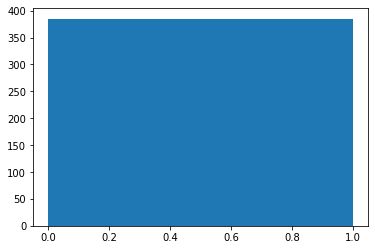

In [35]:
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib import collections as matcoll
inFile = open("BeforeGene_FoundMay11_with_all_pvalues.csv", "r")
all_pvalues = inFile.readline().strip().split(",")
print(all_pvalues[0])
print(float(all_pvalues[0]))
new_list = [float(i) for i in all_pvalues]
#print(all_pvalues)
plt.hist(new_list, bins=30)
plt.show()

In [58]:
import plotly.graph_objects as go
import pandas as pd
pd.set_option('display.max_rows', None)
df = pd.read_csv("PlusOneGene_FoundJune24_with_pattern_pvalue.csv")
fig = go.Figure(data=[go.Table(
    header=dict(values=["gene", "start", "stop", "p_value", "fraction", "s_pvalue", "num_reads", "before_pvalue"],
                fill_color='paleturquoise',
                align='left'),
    cells=dict(values=[df.gene, df.start, df.stop, df.p_value, df.fraction, round(df.stop_pvalue, 4)], #, round(df.num_reads)],
               fill_color='lavender',
               align='left'))])

#fig.show()
df

,gene,start,stop,p_value,fraction,num_reads,stop_pvalue
0,YOR239W,816,1885,10^-8678,0.99,9441,0.000710
1,YPL052W,195,877,10^-144,0.91,192,0.042627
2,YOL040C,87,145,10^-125,0.03,34042,0.000255
3,YJL190C,39,76,10^-110,0.09,11277,0.000237
4,YDR226W,363,403,10^-94,0.10,4478,0.001038
5,YPL240C,1956,2011,10^-90,0.15,2284,0.001402
6,YDL066W,390,481,10^-69,0.07,3504,0.000910
7,YOR046C,51,148,10^-55,0.15,1566,0.000546
8,YER183C,51,109,10^-45,0.41,206,0.000291
9,YLR388W,42,88,10^-43,0.04,5604,0.000838


In [21]:
print("hi")

hi


1.7e-05
1.7e-05


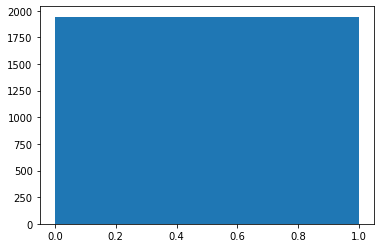

In [51]:
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib import collections as matcoll
inFile = open("codon_speed_PlusOneGene_FoundMay15_all_pattern_pvalues.csv", "r")
all_pvalues = inFile.readline().strip().split(",")
print(all_pvalues[0])
print(float(all_pvalues[0]))
new_list = [float(i) for i in all_pvalues]
#print(all_pvalues)
plt.hist(new_list, bins=30)
plt.show()

21.4
23.0


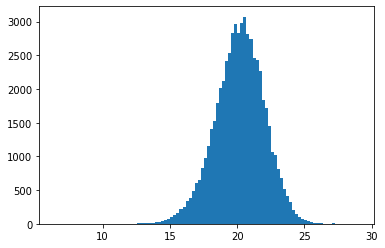

In [65]:
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib import collections as matcoll
inFile = open("codon_speed_PlusOneGene_FoundJune24_all_pattern_speed.csv", "r")
all_pvalues = inFile.readline().strip().split(",")
print(all_pvalues[0])
print(float(all_pvalues[-1]))
new_list = [float(i) for i in all_pvalues]
#print(all_pvalues)
plt.hist(new_list, bins=100)
plt.show()

In [60]:
import plotly.graph_objects as go
import pandas as pd
pd.set_option('display.max_rows', None)
df = pd.read_csv("codon_speed_PlusOneGene_FoundJune24_with_pattern_pvalue.csv")
fig = go.Figure(data=[go.Table(
    header=dict(values=list(df.columns),
                fill_color='paleturquoise',
                align='left'),
    cells=dict(values=[df.gene, df.start, df.stop, df.p_value, df.fraction, round(df.speed_pvalue, 5)],
               fill_color='lavender',
               align='left'))])

#fig.show()
df

,gene,start,stop,p_value,fraction,num_reads,speed_pvalue
0,YHR174W,783,820,10^-103,0.03,58591,0.043524
1,YDR037W,132,250,10^-39,0.05,7866,0.029119
2,YBR031W,1044,1075,10^-35,0.07,9054,0.030440
3,YDR233C,183,241,10^-25,0.05,4588,0.027250
4,YDL084W,933,964,10^-23,0.09,2156,0.038911
5,YKR042W,360,391,10^-23,0.06,2972,0.007494
6,YPL226W,3444,3475,10^-19,0.12,333,0.038929
7,YEL026W,342,373,10^-15,0.13,731,0.005316
8,YJR094C,75,235,10^-14,0.26,99,0.020579
9,YNL209W,1725,1783,10^-13,0.03,5965,0.014611


98


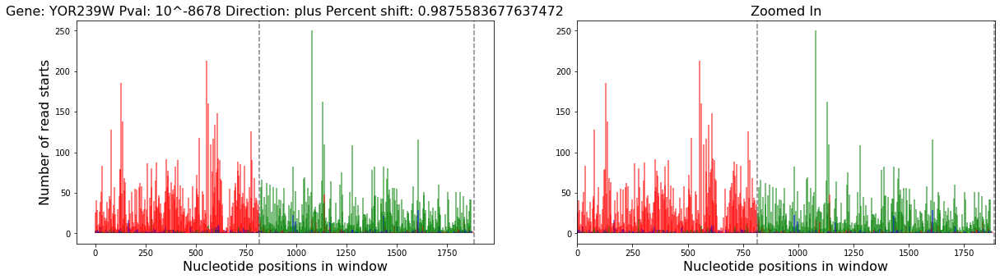

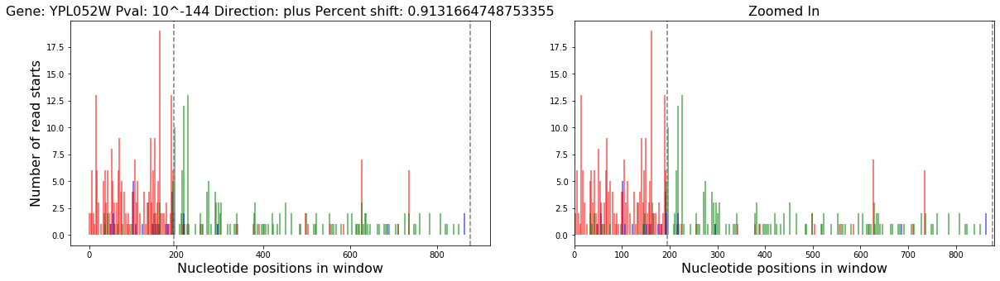

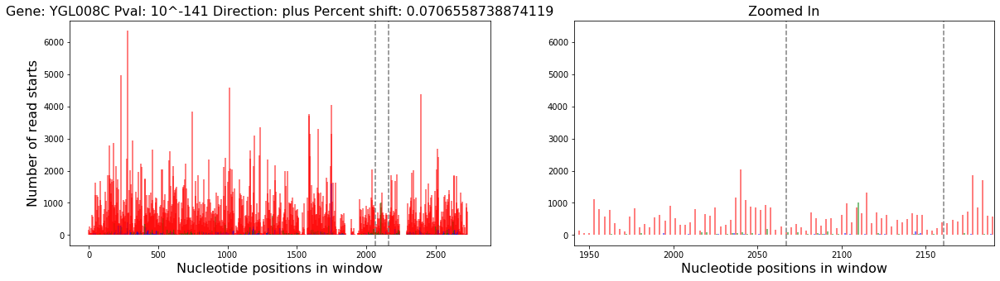

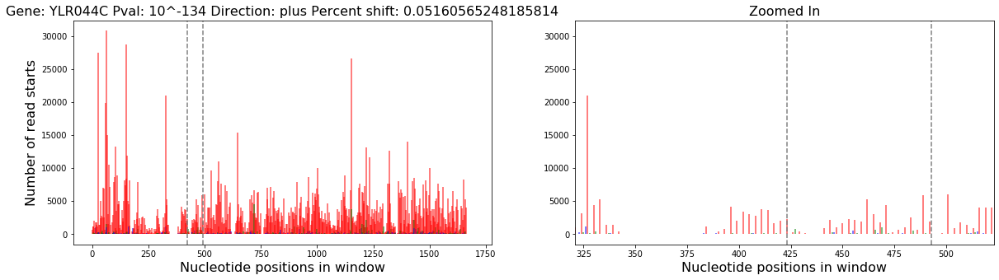

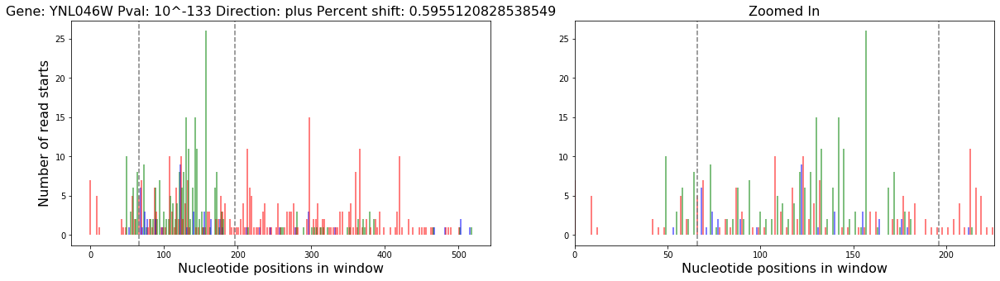

...

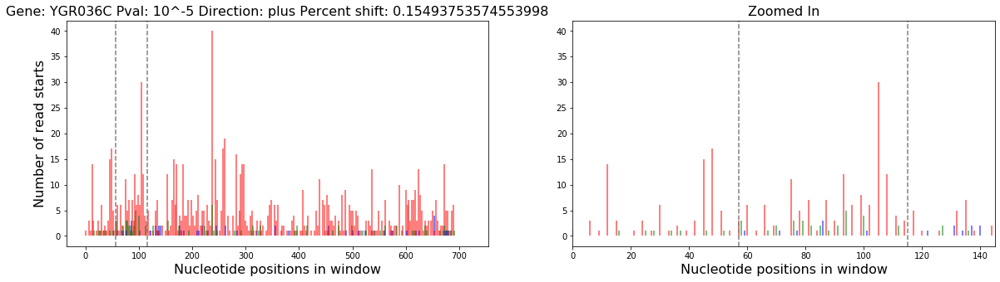

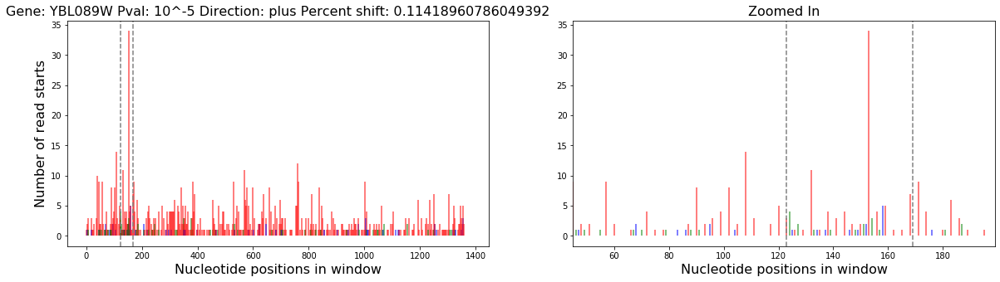

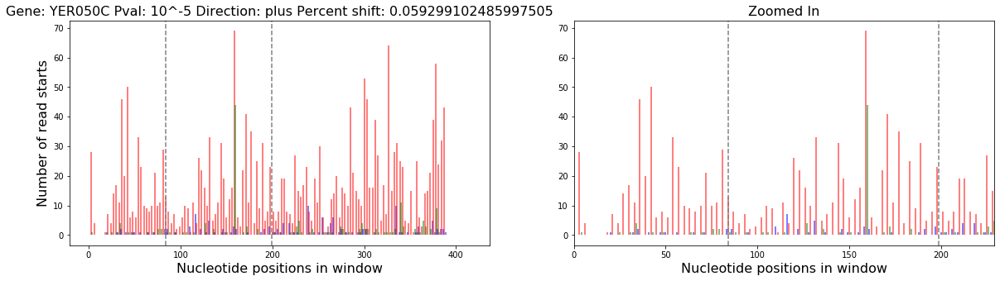

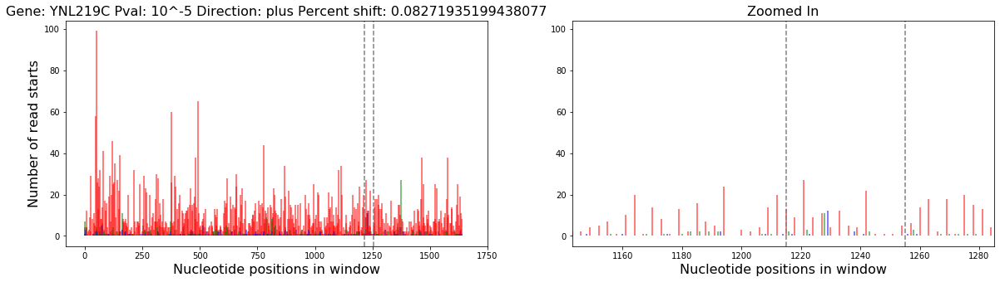

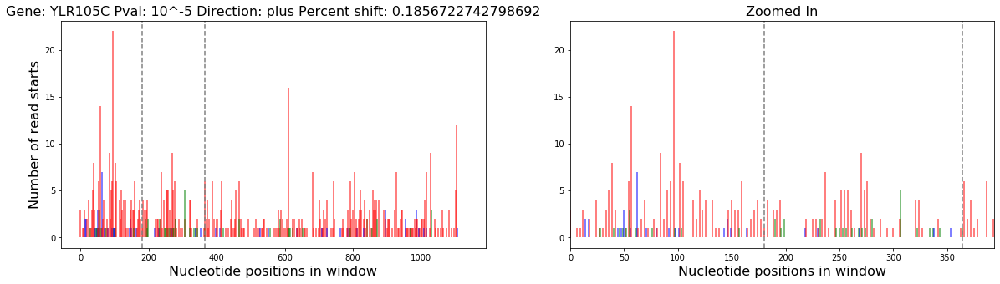

In [42]:
##### THIS is for plus one gene starts

import pandas as pd
import matplotlib.pyplot as plt
from matplotlib import collections as matcoll
inFile = open("output/combined_starts_four_sets_above_90", "r")
gene = inFile.readline().strip()
lineListDict = dict()
while gene:                                                                                                                                                    
    seq = inFile.readline()                                                                                                                                   
    starts_string = inFile.readline()                                                                                                                          
    current_gene = gene                                                                                                                                        
    gene = inFile.readline().strip()                                                                                                                           
    lineList = [int(x) for x in starts_string.strip()[:-1].split(",")] 
    lineListDict[current_gene] = lineList
inFile = open("output/combined_starts_four_sets_above_90_with_found_frameshifts_approach_5.5", "r")
genePDict = dict()
geneShiftStartDict = dict()
geneShiftEndDict = dict()
genePercent = dict()
geneBeforePvalue = dict()
geneNumReads = dict()
geneDirection = dict()
genePlusOne = dict()
for line in inFile:
    Info_string = line.strip()
    letters = inFile.readline().rstrip("\n").split(" ")
    reads_1 = inFile.readline().rstrip("\n").split(" ")
    reads_2 = inFile.readline().rstrip("\n").split(" ")
    percents = inFile.readline().rstrip("\n").split(",")
    blank = inFile.readline()
    gene_name = Info_string.split("\t")[0].split(" ")[1]
    p_value  = float(Info_string.split("\t")[1].split(" ")[1])

    
    detected_shift = int(Info_string.split("\t")[3].split(" ")[1])
    detected_shift_end = detected_shift + int(Info_string.split("\t")[4].split(" ")[1])
    
    geneDirection[gene_name] = Info_string.split("\t")[5].split(" ")[1]
    if ( Info_string.split("\t")[6].split(" ")[1] == "no" ):
        if (geneDirection[gene_name] == "plus"):
            genePlusOne[gene_name] = "yes"
    genePercent[gene_name] = float(Info_string.split("\t")[7].split(" ")[1])
    
    geneNumReads[gene_name] = float(Info_string.split("\t")[8].split(" ")[1])
    geneBeforePvalue[gene_name] = float(Info_string.split("\t")[9].split(" ")[1])

    genePDict[gene_name] = p_value
    geneShiftStartDict[gene_name] = detected_shift
    geneShiftEndDict[gene_name] = detected_shift_end
    
sorted_PVals = sorted(genePDict.items(), key=lambda x: x[1])

# now process the ids file
#sgdToGeneName = dict()
#inFile = open("saccharomyces_cerevisiae_gene_info.csv", "r")
#inFile.readline()
#for line in inFile:
#    i_string = line.strip().split("\t")
#    sgdToGeneName[i_string[1]] = i_string[3].split(" ")[0]
    
#print(sgdToGeneName["SGDID:S0007283"])

# now process the secondary structure file - this was the initial filter to see we can compare to PRFDB
    #inFile = open("saccharomyces_cerevisiae_mfe.csv", "r")
#inFile.readline()
#geneStructuresDict = dict()
#geneDistDict = dict()
#for line in inFile:
#    i_string = line.strip().split("\t")
#    if (i_string[2] in sgdToGeneName):
#        gene_name = sgdToGeneName[i_string[2]]
#        if (gene_name in genePDict):
#found += 1
##if (gene_name not in geneStructuresDict):
#            start = int(i_string[4])
#            my_start = geneShiftStartDict[gene_name]
#            if (abs(start - my_start) < 30):
#                geneStructuresDict[gene_name] = i_string
            #TODO: decide if want to have a distance cut-off, like 10 or 30, of get best distance first, and then do cut-offs??
#print(found)
#print(len(geneStructuresDict))
#for gene_name in geneStructuresDict:
    #print(geneStructuresDict[gene_name])
    #print(genePDict[gene_name])

print(len(geneBefore))
    
outFile = open("PlusOneGene_FoundJune24.csv", "w")
for (gene, p_val) in sorted_PVals:
    
    ### un-comment this line to get only things with PRFDB secondary structures...
    ##if gene not in geneStructuresDict:
     ##   continue
    if gene not in genePlusOne:
        continue
        
    lines = []
    lineList = lineListDict[gene]
    for i in range(0, len(lineList)):  # YDL061C,87,140,-1,0.05; -54.349  #YLR388W,75,140,-1,0.05; -30.754
        pair=[(i,0), (i, lineList[i])]
        lines.append(pair)
    linecoll = matcoll.LineCollection(lines, colors=["red","green", "blue"], linewidths=[2], alpha=0.5)
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 5))
    ax1.add_collection(linecoll)
    ax1.axvline(x=geneShiftStartDict[gene], c="gray", linestyle='--')
    ax1.axvline(x=geneShiftEndDict[gene], c="gray", linestyle='--')
    ax1.autoscale_view()
    ax1.set_title("Gene: " + str(gene) + " Pval: 10^" + str(round(p_val)) + " Direction: " + geneDirection[gene] + " Percent shift: " + str(genePercent[gene]),fontsize=16)
    ax1.set_xlabel('Nucleotide positions in window',fontsize=16)
    ax1.set_ylabel('Number of read starts',fontsize=16)
    
    
    start = 2 * geneShiftStartDict[gene] - geneShiftEndDict[gene]
    start = max(0, start - start%3 - 30)
    end = min(geneShiftEndDict[gene] + 30, len(lineList))
    lineList = lineListDict[gene]
    lines= []
    for i in range(0, len(lineList)): 
        pair=[(i,0), (i, lineList[i])]
        lines.append(pair)
    linecoll = matcoll.LineCollection(lines, colors=["red","green", "blue"], linewidths=[2], alpha=0.5)
    ax2.add_collection(linecoll)
    ax2.axvline(x=geneShiftStartDict[gene], c="gray", linestyle='--')
    ax2.axvline(x=geneShiftEndDict[gene], c="gray", linestyle='--')
    ax2.autoscale_view()
    ax2.set_title("Zoomed In",fontsize=16)
    ax2.set_xlabel('Nucleotide positions in window',fontsize=16)
    ax2.set_xlim(start, end)
    #ax2.set_ylabel('Number of read starts',fontsize=16)
    plt.show()
    #outFile.write(gene + ","+geneDirection[gene] + "\n")
    outFile.write(gene + "," + str(geneShiftStartDict[gene]) + "," + str(geneShiftEndDict[gene]) + ",10^" + str(round(p_val)) + "," + str(round(genePercent[gene],2)) + "," + str(geneNumReads[gene]) + "," + str(round(geneBeforePvalue[gene])) +  "\n")
    #outFile.write(gene + ",10^" + str(p_val) + "," + str(geneShiftStartDict[gene]) + "," + str(geneShiftEndDict[gene]) + "," + str(geneShiftEndDict[gene]%3+1) + "\n")
outFile.close()

98


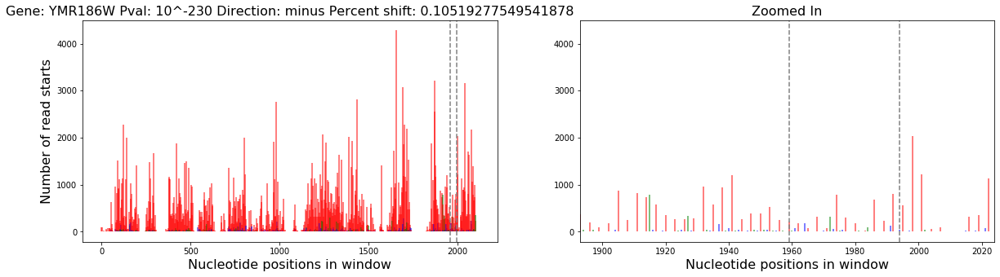

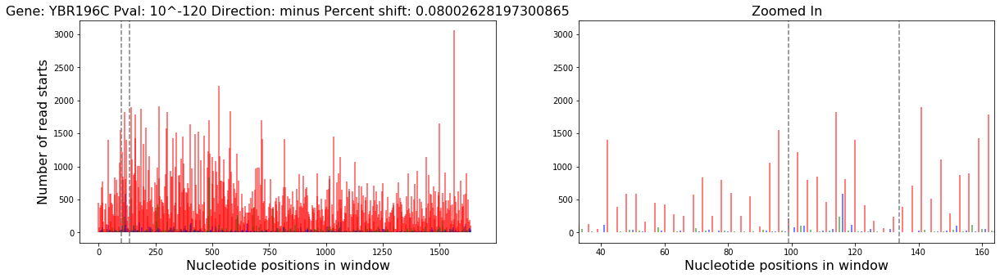

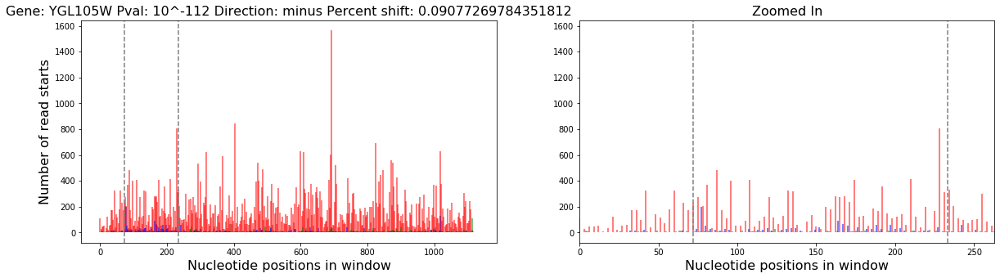

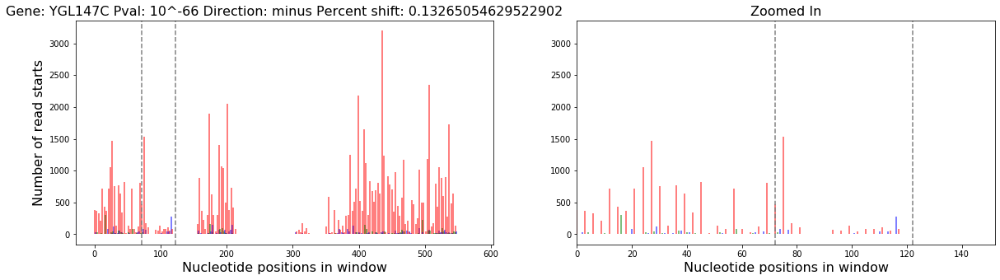

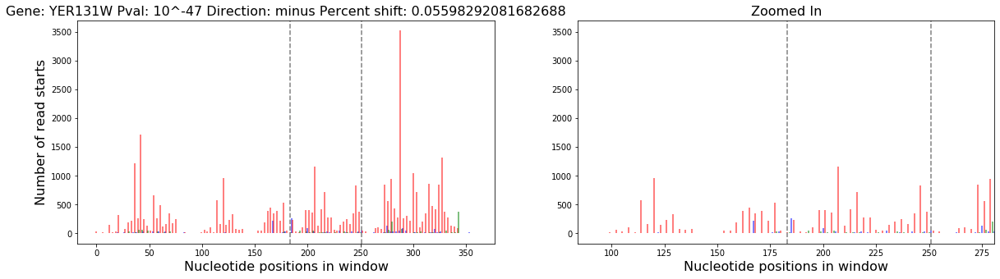

...

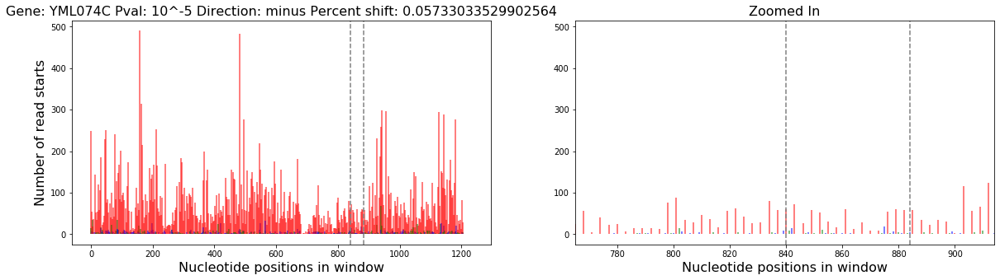

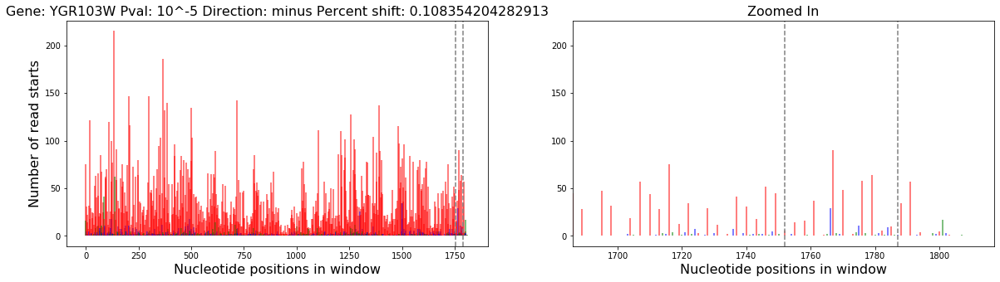

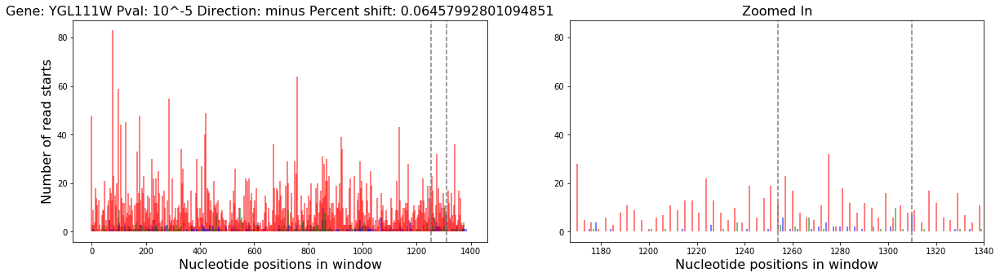

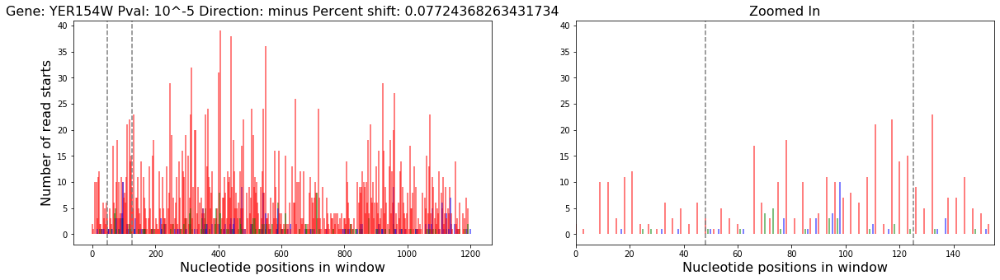

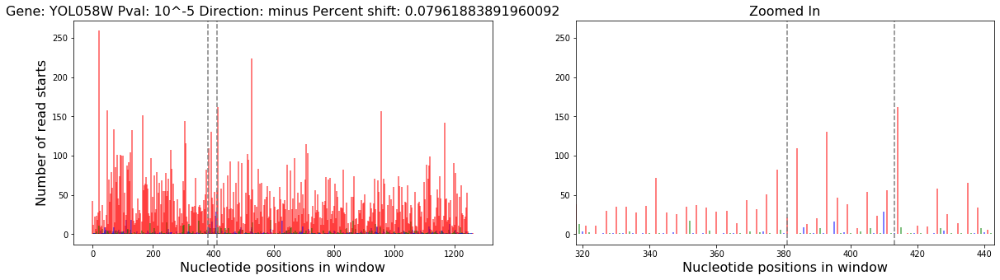

In [66]:
##### THIS is for plus one gene starts

import pandas as pd
import matplotlib.pyplot as plt
from matplotlib import collections as matcoll
inFile = open("output/combined_starts_four_sets_above_90", "r")
gene = inFile.readline().strip()
lineListDict = dict()
while gene:                                                                                                                                                    
    seq = inFile.readline()                                                                                                                                   
    starts_string = inFile.readline()                                                                                                                          
    current_gene = gene                                                                                                                                        
    gene = inFile.readline().strip()                                                                                                                           
    lineList = [int(x) for x in starts_string.strip()[:-1].split(",")] 
    lineListDict[current_gene] = lineList
inFile = open("output/combined_starts_four_sets_above_90_with_found_frameshifts_approach_5.5", "r")
genePDict = dict()
geneShiftStartDict = dict()
geneShiftEndDict = dict()
genePercent = dict()
geneBeforePvalue = dict()
geneNumReads = dict()
geneDirection = dict()
geneMinusOne = dict()
for line in inFile:
    Info_string = line.strip()
    letters = inFile.readline().rstrip("\n").split(" ")
    reads_1 = inFile.readline().rstrip("\n").split(" ")
    reads_2 = inFile.readline().rstrip("\n").split(" ")
    percents = inFile.readline().rstrip("\n").split(",")
    blank = inFile.readline()
    gene_name = Info_string.split("\t")[0].split(" ")[1]
    p_value  = float(Info_string.split("\t")[1].split(" ")[1])

    
    detected_shift = int(Info_string.split("\t")[3].split(" ")[1])
    detected_shift_end = detected_shift + int(Info_string.split("\t")[4].split(" ")[1])
    
    geneDirection[gene_name] = Info_string.split("\t")[5].split(" ")[1]
    if ( Info_string.split("\t")[6].split(" ")[1] == "no" ):
        if (geneDirection[gene_name] == "minus"):
            geneMinusOne[gene_name] = "yes"
    genePercent[gene_name] = float(Info_string.split("\t")[7].split(" ")[1])
    
    geneNumReads[gene_name] = float(Info_string.split("\t")[8].split(" ")[1])
    geneBeforePvalue[gene_name] = float(Info_string.split("\t")[9].split(" ")[1])

    genePDict[gene_name] = p_value
    geneShiftStartDict[gene_name] = detected_shift
    geneShiftEndDict[gene_name] = detected_shift_end
    
sorted_PVals = sorted(genePDict.items(), key=lambda x: x[1])

# now process the ids file
#sgdToGeneName = dict()
#inFile = open("saccharomyces_cerevisiae_gene_info.csv", "r")
#inFile.readline()
#for line in inFile:
#    i_string = line.strip().split("\t")
#    sgdToGeneName[i_string[1]] = i_string[3].split(" ")[0]
    
#print(sgdToGeneName["SGDID:S0007283"])

# now process the secondary structure file - this was the initial filter to see we can compare to PRFDB
#inFile = open("saccharomyces_cerevisiae_mfe.csv", "r")
#inFile.readline()
#geneStructuresDict = dict()
#geneDistDict = dict()
#for line in inFile:
#    i_string = line.strip().split("\t")
#    if (i_string[2] in sgdToGeneName):
#        gene_name = sgdToGeneName[i_string[2]]
#        if (gene_name in genePDict):
#found += 1
##if (gene_name not in geneStructuresDict):
#            start = int(i_string[4])
#            my_start = geneShiftStartDict[gene_name]
#            if (abs(start - my_start) < 30):
#                geneStructuresDict[gene_name] = i_string
            #TODO: decide if want to have a distance cut-off, like 10 or 30, of get best distance first, and then do cut-offs??
#print(found)
#print(len(geneStructuresDict))
#for gene_name in geneStructuresDict:
    #print(geneStructuresDict[gene_name])
    #print(genePDict[gene_name])

print(len(geneBefore))
    
outFile = open("MinusOneGene_FoundJune30.csv", "w")
for (gene, p_val) in sorted_PVals:
    
    ### un-comment this line to get only things with PRFDB secondary structures...
    ##if gene not in geneStructuresDict:
     ##   continue
    if gene not in geneMinusOne:
        continue
        
    lines = []
    lineList = lineListDict[gene]
    for i in range(0, len(lineList)):  # YDL061C,87,140,-1,0.05; -54.349  #YLR388W,75,140,-1,0.05; -30.754
        pair=[(i,0), (i, lineList[i])]
        lines.append(pair)
    linecoll = matcoll.LineCollection(lines, colors=["red","green", "blue"], linewidths=[2], alpha=0.5)
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 5))
    ax1.add_collection(linecoll)
    ax1.axvline(x=geneShiftStartDict[gene], c="gray", linestyle='--')
    ax1.axvline(x=geneShiftEndDict[gene], c="gray", linestyle='--')
    ax1.autoscale_view()
    ax1.set_title("Gene: " + str(gene) + " Pval: 10^" + str(round(p_val)) + " Direction: " + geneDirection[gene] + " Percent shift: " + str(genePercent[gene]),fontsize=16)
    ax1.set_xlabel('Nucleotide positions in window',fontsize=16)
    ax1.set_ylabel('Number of read starts',fontsize=16)
    
    
    start = 2 * geneShiftStartDict[gene] - geneShiftEndDict[gene]
    start = max(0, start - start%3 - 30)
    end = min(geneShiftEndDict[gene] + 30, len(lineList))
    lineList = lineListDict[gene]
    lines= []
    for i in range(0, len(lineList)): 
        pair=[(i,0), (i, lineList[i])]
        lines.append(pair)
    linecoll = matcoll.LineCollection(lines, colors=["red","green", "blue"], linewidths=[2], alpha=0.5)
    ax2.add_collection(linecoll)
    ax2.axvline(x=geneShiftStartDict[gene], c="gray", linestyle='--')
    ax2.axvline(x=geneShiftEndDict[gene], c="gray", linestyle='--')
    ax2.autoscale_view()
    ax2.set_title("Zoomed In",fontsize=16)
    ax2.set_xlabel('Nucleotide positions in window',fontsize=16)
    ax2.set_xlim(start, end)
    #ax2.set_ylabel('Number of read starts',fontsize=16)
    plt.show()
    #outFile.write(gene + ","+geneDirection[gene] + "\n")
    outFile.write(gene + "," + str(geneShiftStartDict[gene]) + "," + str(geneShiftEndDict[gene]) + ",10^" + str(round(p_val)) + "," + str(round(genePercent[gene],2)) + "," + str(geneNumReads[gene]) + "," + str(round(geneBeforePvalue[gene])) +  "\n")
    #outFile.write(gene + ",10^" + str(p_val) + "," + str(geneShiftStartDict[gene]) + "," + str(geneShiftEndDict[gene]) + "," + str(geneShiftEndDict[gene]%3+1) + "\n")
outFile.close()

In [67]:
import plotly.graph_objects as go
import pandas as pd
pd.set_option('display.max_rows', None)
df = pd.read_csv("MinusOneGene_FoundJune30_with_pattern_pvalue.csv")
fig = go.Figure(data=[go.Table(
    header=dict(values=list(df.columns),
                fill_color='paleturquoise',
                align='left'),
    cells=dict(values=[df.gene, df.start, df.stop, df.p_value, df.fraction, round(df.spe_pvalue, 5)],
               fill_color='lavender',
               align='left'))])

#fig.show()
df

AttributeError: 'DataFrame' object has no attribute 'gene'